# 🐱 Meows & 🐶 Woofs Classification With Neural Network

**นาย จาริก ศิลปาภินันท์ 5933609023**

**สารบัญ**
    1. Feature Extraction
    2. Building the classification model
    3. สรุปและวิจารณ์ผล
**Library ที่เรียกใช้มีดังต่อไปนี้**
    1. os : ใช้ในการเข้าถึง Directory ที่ต้องการ
    2. numpy : ใช้สำหรับเก็บข้อมูล
    3. pandas : ใช้สำหรับนำเข้าข้อมูลแสดงผลและวิเคราะห์ผลในรูปแบบ Series และ Data frame
    4. matplotlib & seaborn : ใช้ทำ Data Virtualization
    5. sklearn & keras : เป็น tools ที่ใช้สำหรับงาน Data Mining และ Data Analysis
    6. librosa : ใช้สำหรับอ่าน Audio File (.wav) และทำ Mel Spectrogram
    7. cv2 : ใช้สำหรับอ่าน Image File (.png)
    8. sys : ใช้สำหรับแสดง Status Bar ของการทำงานโดยดูจากจำนวนการวน loop

In [1]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report, roc_auc_score, roc_curve
import librosa
import librosa.display
import IPython.display as ipd
import seaborn as sns
import cv2
import sys
import warnings
warnings.filterwarnings('ignore')

# 1. Feature Extraction
    ในการสกัด Feature ของไฟล์เสียงจะแบ่งข้อมูลสำหรับ train และ test เป็นสองกลุ่มเพื่อสอดรับกับรูปแบบการรับข้อมูลของ Multilayer Perceptron และ Convolution Neural Network โดยมีรายละเอียดต่าง ๆ ดังนี้

**1.1.) การสกัด Mel Spectrogram ของไฟล์เสียงแล้วเซฟเก็บเป็นไฟล์รูปภาพ**

    1.1.1.) กำหนด Directory สำหรับการเข้าไปอ่านชื่อ Audio File ในโฟร์เดอร์ cats_dogs_dataset ด้วย os.chdir แล้วทำการเช็ค Directory ปัจจุบันด้วย os.getcwd

In [2]:
inDir = os.chdir('cats_dogs_dataset') # Select the directory
retval = os.getcwd() # Check current working directory
print(retval)

/Users/knight12738/Documents/ProjectML/Project/cats_dogs_dataset


    1.1.2.) เก็บชื่อไฟล์ทั้งหมดลงใน entire_fnames ซึ่งเป็น list ด้วย os.listdir แล้วทำการสร้าง Data Frame ของข้อมูลไฟล์เหล่านั้นเพื่อความง่ายในการเข้าถึง Audio File เพื่อสกัด Mel Spectrogram

In [3]:
entire_fnames = os.listdir(inDir)
entire_fnames.remove('.DS_Store')
entire_df = pd.DataFrame()
for e in entire_fnames:
    tmp = {'File Name':[e[-500:-4]]}
    features = pd.DataFrame(data = tmp)
    features['Label'] = e[:3]
    entire_df = entire_df.append(features)
entire_df = entire_df.reset_index()
entire_df.drop(['index'], axis = 1, inplace = True)
print('Shape : ', entire_df.shape)
entire_df.head()

Shape :  (251, 2)


,File Name,Label
0,cat_74,cat
1,dog_barking_63,dog
2,cat_60,cat
3,dog_barking_77,dog
4,cat_48,cat


In [4]:
os.chdir("..")
retval = os.getcwd() # Check current working directory
print(retval)

/Users/knight12738/Documents/ProjectML/Project


    1.1.3.) เนื่องจากความยาวของ Audio File ในแต่ละไฟล์ไม่เท่ากัน เพื่อให้ผลลัพธ์ในการ Classify มีความถูกต้องมากที่สุดจึงต้องทำการยืด scale ของ Time Domain ในรูป Mel Spectrogram ที่สกัดมาจากแต่ละ Audio File ให้มีความกว้างและความยาวของรูปทุกรูปเท่ากัน ในขั้นแรกทำการหา Max Sound Length ของ Audio File ทั้งหมด และ ในขั้นที่ 2 นำเอา Max Sound Length ที่ได้มาหาผลต่างกับ Sound Length ของ Audio File ที่กำลังพิจรณาอยู่ เมื่อได้ผลต่างมาแล้วทำการเติม 0 เป็นจำนวนเท่ากับผลต่างที่ได้ลง sign ซึ่งเป็น numpy array ที่สกัดมาจาก librosa.load โดยส่วนที่ถูก Extend มาจะเป็นส่วนที่ไม่มีสัญญาณเสียงใดๆเป็นเพียงการขยาย Time Domian ให้เท่ากันเท่านั้น

In [5]:
lr = list()
ls = list()
for i in range(len(entire_df)):
    fname = entire_df.at[i, 'File Name']
    sign, rate = librosa.load('cats_dogs_dataset/' + fname + '.wav')
    lr.append(rate)
    ls.append(len(sign))
    sys.stdout.write('\r')
    sys.stdout.write("Reading Audio Files. |%-80s| %d%%" % ('#' * int((80/(len(entire_df) - 1)) * i)
                                                                 , (100/(len(entire_df) - 1)) * i))
    sys.stdout.flush()
max_soundLen = max(ls)
print()
print('Analyzing Data...')
print('Sampling Rate : ', sum(lr) / len(lr))
print('Max Sound Length : ', max_soundLen)

Reading Audio Files. |################################################################################| 100%
Analyzing Data...
Sampling Rate :  22050.0
Max Sound Length :  396371


    1.1.4.) ทำการบันทึก Mel Spectrogram ของแต่ละ Audio File เป็น .png โดยใช้ชื่อเดียวกันกับ Audio File ไว้ในโฟร์เดอร์ชื่อ cat_dog_spectrogram ที่อยู่ใน Directory เดียวกับไฟล์ Jupyter Notebook นี้

Reading Audio Files. |################################################################################| 100%
Mel-Spectrogram was Completed.


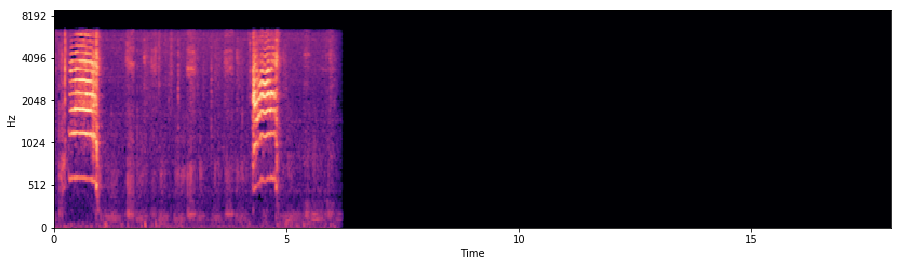

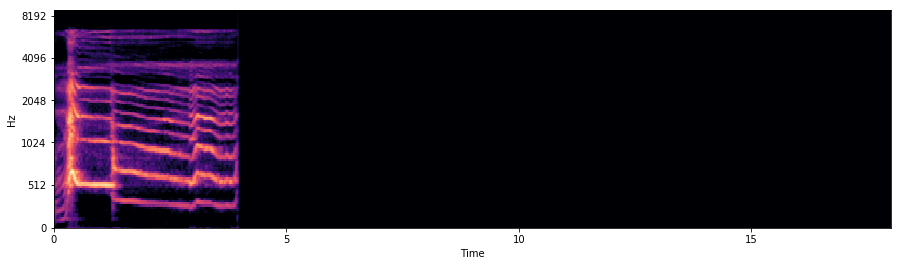

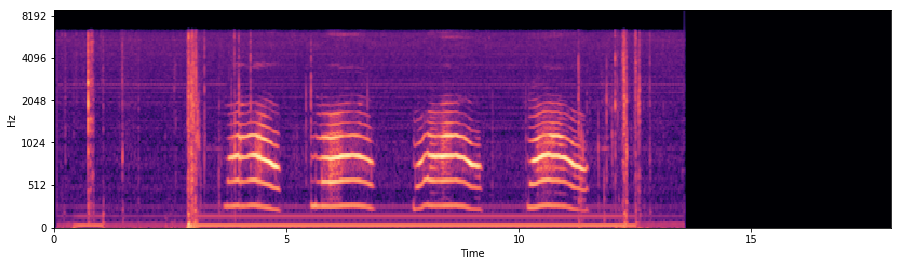

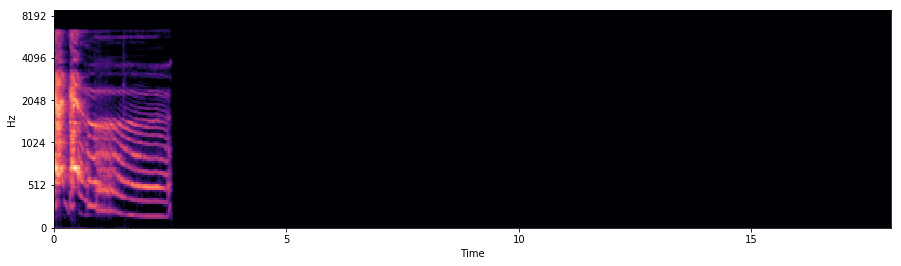

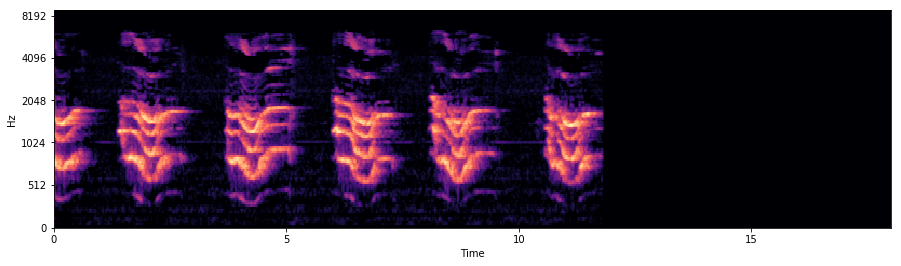

...

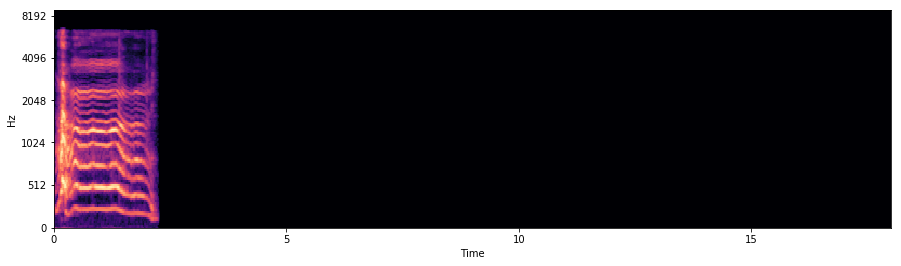

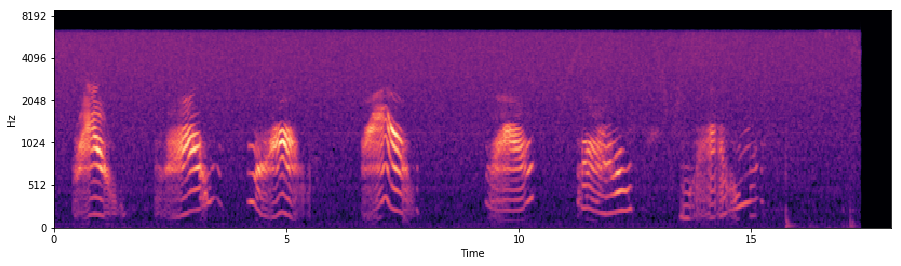

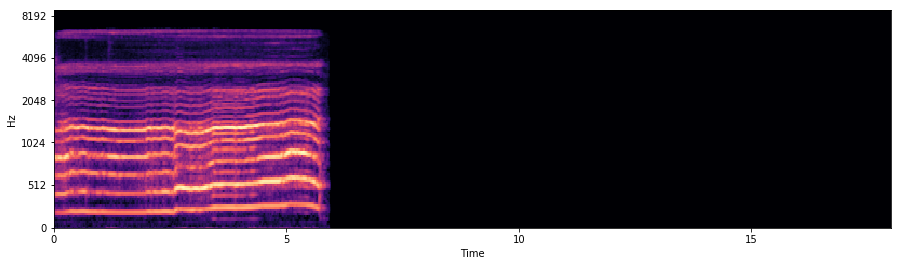

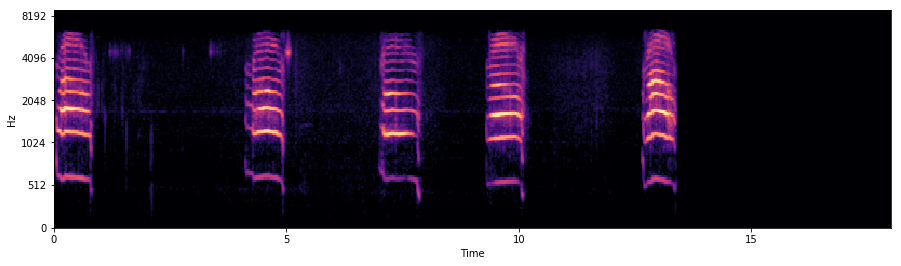

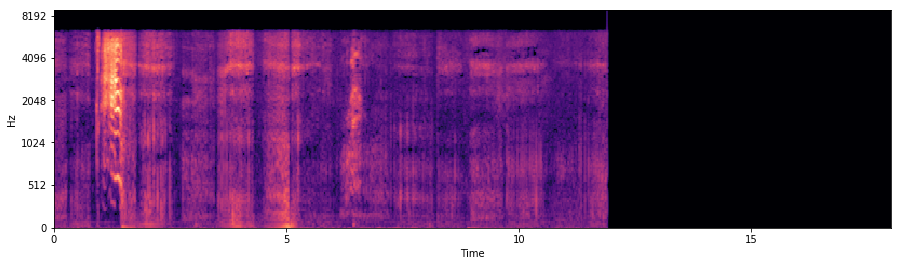

In [6]:
entire_df.at[2, 'File Name']
for i in range(len(entire_df)):
    fname = entire_df.at[i, 'File Name']
    sign, rate = librosa.load('cats_dogs_dataset/' + fname + '.wav')
    extend_sign = max_soundLen - len(sign)
    extend = np.zeros(extend_sign)
    sign = np.append(sign, extend)
    pre_emphasis = 0.97
    emphasized_signal = np.append(sign[0], sign[1:] - pre_emphasis * sign[:-1])
    mel_spectro = librosa.feature.melspectrogram(y = emphasized_signal, sr = rate)
    plt.subplots(figsize=(15, 4))
    librosa.display.specshow(librosa.power_to_db(mel_spectro, ref = np.max), y_axis = 'mel', 
                         x_axis = 'time', fmin = 0,  fmax = 9000)
    plt.savefig('cat_dog_spectrogram/' + fname)
    sys.stdout.write('\r')
    sys.stdout.write("Reading Audio Files. |%-80s| %d%%" % ('#' * int((80/(len(entire_df) - 1)) * i)
                                                                 , (100/(len(entire_df) - 1)) * i))
    sys.stdout.flush()
print()
print('Mel-Spectrogram was Completed.')

**1.2.) การเตรียม Data สำหรับ Multilayer Perceptron**

    1.2.1.) กำหนด Directory ใหม่เพื่อทำการอ่านชื่อไฟล์ทุกไฟล์ใน Directory โดยชื่อไฟล์ทั้งหมดจะถูกเก็บไว้ใน entire_imname ซึ่งเป็น list ด้วย os.listdir

In [7]:
inDir = os.chdir('cat_dog_spectrogram') # Select the directory
retval = os.getcwd() # Check current working directory
print(retval)

/Users/knight12738/Documents/ProjectML/Project/cat_dog_spectrogram


In [8]:
entire_imname = os.listdir(inDir)
entire_imname.remove('.DS_Store')

    1.2.2.) ทำการอ่านไฟล์รูปภาพจากขั้นตอน 1.1) (อ่านไฟล์ตามชื่อไฟล์ใน entire_imname)โดยในแต่ละภาพจะเลือกเฉพาะส่วนที่เป็นพื้นที่ของ Spectrogram มาทำการลดขนาดลงจาก 215x838 เหลือ 175x682 เพื่อความเร็วในการ train ข้อมูล จากนั้นจึงทำการแปลงรูปจาก BGR เป็น RGB แล้วทำการ reshape ข้อมูลจากภาพที่เป็น 2 มิติ(682x175x3)ให้กลายเป็น vector มิติเดียว(358050)เพื่อความสะดวกในการ train ข้อมูล สุดท้ายทำการแปลง scale ข้อมูลให้เล็กลงด้วยการหาร 255 ซึ่งเป็นค่ามากสุดของระดับสี RGB แล้วนำข้อมูลเหล่านี้ของภาพหนึ่งภาพมาเก็บลงในรูปแบบ list จากนั้นจึงนำ list ต่าง ๆ ของทุก ๆ ภาพมาเก็บใส่ใน entireIm_list แปลงเป็น Data Frame ชื่อ entireIm_MLP ดังนี้

In [9]:
i = 0
entireIm_list = list()
for e in entire_imname:
    input_image = cv2.imread(e)
    input_image = input_image[37:252, 134:972]
    input_image = cv2.resize(input_image, (682, 175))
    image = cv2.cvtColor(input_image, cv2.COLOR_BGR2RGB)
    image = image.reshape(358050)
    image = image / 255.0
    tmp = list(image)
    tmp.append(e[:3])
    entireIm_list.append(tmp)
    sys.stdout.write('\r')
    sys.stdout.write("Reading Spectrogram Image. |%-80s| %d%%" % ('#' * int((80/(len(entire_imname) - 1)) * i)
                                                                 , (100/(len(entire_imname) - 1)) * i))
    sys.stdout.flush()
    i += 1
print()
print('Creating Data Frame.....')
entireIm_MLP = pd.DataFrame(entireIm_list)
entireIm_MLP.rename(columns = {358050:'Label'}, inplace = True)
print('entireIm_MLP was completed.')
print('Shape : ', entireIm_MLP.shape)
entireIm_MLP.head()

Reading Spectrogram Image. |################################################################################| 100%
Creating Data Frame.....
entireIm_MLP was completed.
Shape :  (251, 358051)


,0,1,2,3,4,5,6,7,8,9,...,358041,358042,358043,358044,358045,358046,358047,358048,358049,Label
0,0.886275,0.886275,0.886275,0.000000,0.000000,0.003922,0.000000,0.000000,0.015686,0.0,...,0.0,0.0,0.015686,0.0,0.0,0.015686,0.0,0.0,0.015686,cat
1,0.890196,0.886275,0.894118,0.066667,0.031373,0.152941,0.047059,0.027451,0.125490,0.0,...,0.0,0.0,0.015686,0.0,0.0,0.015686,0.0,0.0,0.015686,cat
2,0.886275,0.886275,0.886275,0.000000,0.000000,0.003922,0.000000,0.000000,0.015686,0.0,...,0.0,0.0,0.015686,0.0,0.0,0.015686,0.0,0.0,0.015686,dog
3,0.886275,0.886275,0.886275,0.000000,0.000000,0.003922,0.000000,0.000000,0.015686,0.0,...,0.0,0.0,0.015686,0.0,0.0,0.015686,0.0,0.0,0.015686,cat
4,0.886275,0.886275,0.886275,0.000000,0.000000,0.003922,0.000000,0.000000,0.015686,0.0,...,0.0,0.0,0.015686,0.0,0.0,0.015686,0.0,0.0,0.015686,cat


**1.3.) การเตรียม Data สำหรับ Convolution Neural Network** จะอธิบายใน Convolution Neural Network ซึ่งอยู่ในส่วน Building the classification model

# 2. Building the classification model

**2.1.) Multilayer Perceptron** : กำหนด Parameters ต่าง ๆ เป็น Default ทั้งหมด

In [10]:
X = entireIm_MLP.iloc[:, :358050]
y = entireIm_MLP.iloc[:, -1]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 1)

In [11]:
y_train_df = pd.DataFrame(y_train)
y_train_df['Label'].value_counts()

cat    112
dog     88
Name: Label, dtype: int64

In [12]:
y_test_df = pd.DataFrame(y_test)
y_test_df['Label'].value_counts()

cat    31
dog    20
Name: Label, dtype: int64

In [13]:
from sklearn.neural_network import MLPClassifier

In [14]:
MLP_model = MLPClassifier(random_state = 1)
MLP_model.fit(X_train, y_train)
MLP_predicted = MLP_model.predict(X_test)

              precision    recall  f1-score   support

         cat       0.90      0.90      0.90        31
         dog       0.85      0.85      0.85        20

   micro avg       0.88      0.88      0.88        51
   macro avg       0.88      0.88      0.88        51
weighted avg       0.88      0.88      0.88        51

Accuracy Score :  0.8823529411764706


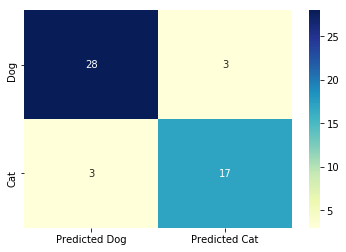

In [15]:
MLP_Acc = accuracy_score(y_test, MLP_predicted)
print(classification_report(y_test, MLP_predicted))
print('Accuracy Score : ', MLP_Acc)
conf_matrix = confusion_matrix(y_test, MLP_predicted)
label = ['Dog', 'Cat']
label_pred = ['Predicted Dog','Predicted Cat']
sns.heatmap(conf_matrix, annot = True, xticklabels = label_pred, yticklabels = label, fmt = 'd', cmap = 'YlGnBu')

**2.2) Multilayer Perceptron with GridSearchCV** : ทดลองทำ Grid Search และ 5-fold cross validation โมเดล MLP โดยมีการ tuning hyperparameter ต่าง ๆ ดังนี้

    2.2.1.) max_iter : tuning ค่าระหว่าง 200 และ 500
    2.2.2.) solver : กำหนดให้เป็น adam
    2.2.3.) hidden layer sizes : tuning ค่าระหว่าง (50, 50, 50) และ (100,)

   ***หมายเหตุ*** : มีการลอง tuning hyperparameters มากกว่าใน 2.2.1.) แล้วแต่ใช้เวลาในการ train ข้อมูลนานมาก (เป็นชั่วโมง) จึงทดลอง tuning hyperparameters แค่บางตัว

In [16]:
from sklearn.pipeline import make_pipeline
from sklearn.model_selection import GridSearchCV

In [17]:
pipe_MLP = make_pipeline(MLPClassifier(random_state = 1))
param_grid_MLP = {'mlpclassifier__solver':['adam'], 'mlpclassifier__max_iter':[200, 500],
                 'mlpclassifier__hidden_layer_sizes':[(50, 50, 50), (100,)]}
gridSearch_MLP = GridSearchCV(estimator = pipe_MLP, param_grid = param_grid_MLP, 
                               scoring = 'accuracy', cv = 5, refit = True, n_jobs = -1)
gridSearch_MLP.fit(X_train, y_train)
print('Multilayer Perceptron with Grid Search')
print('Best Accuracy Score : ', gridSearch_MLP.best_score_)
print(gridSearch_MLP.best_params_)

Multilayer Perceptron with Grid Search
Best Accuracy Score :  0.865
{'mlpclassifier__hidden_layer_sizes': (50, 50, 50), 'mlpclassifier__max_iter': 200, 'mlpclassifier__solver': 'adam'}


              precision    recall  f1-score   support

         cat       0.90      0.84      0.87        31
         dog       0.77      0.85      0.81        20

   micro avg       0.84      0.84      0.84        51
   macro avg       0.83      0.84      0.84        51
weighted avg       0.85      0.84      0.84        51

Accuracy Score :  0.8431372549019608


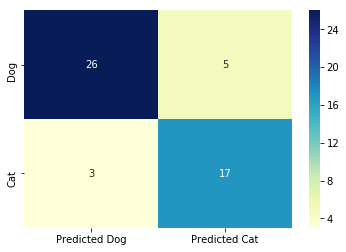

In [19]:
gridSearch_MLP_predicted = gridSearch_MLP.predict(X_test)
gridSearch_MLP_Acc = accuracy_score(y_test, gridSearch_MLP_predicted)
print(classification_report(y_test, gridSearch_MLP_predicted))
print('Accuracy Score : ', gridSearch_MLP_Acc)
conf_matrix = confusion_matrix(y_test, gridSearch_MLP_predicted)
label = ['Dog', 'Cat']
label_pred = ['Predicted Dog','Predicted Cat']
sns.heatmap(conf_matrix, annot = True, xticklabels = label_pred, yticklabels = label, fmt = 'd', cmap = 'YlGnBu')

**2.2.) Convolution Neural Network** : เป็นรูปแบบหนึ่งของ feed-forward และก็จัดเป็น Deep Learning ประเภทหนึ่ง โดยในส่วนของ Hidden Layer นั้นจะมีส่วนของ Convolution Layer เพิ่มเข้ามาซึ่งเป็นส่วนที่มีการฟิลเตอร์รูปภาพเพื่อทำ Feature Extraction ก่อนเข้าส่วน Fully-Connected Neural Network ต่อไป โดยมีรายละเอียดดังต่อไปนี้

    2.2.1) และ 1.3.) ขั้นตอนการเตรียมข้อมูลและเนื่องจาก CNN มี Convolution Layer เพิ่มเข้ามาเราจึงไม่มีความจำเป็นต้องทำ Feature Extraction ทำแค่การอ่านรูป Spectrogram เข้ามา และ ระบุว่า Spectrogram นี้เป็นของหมาหรือแมวแล้วนำข้อมูลต่าง ๆ มาเก็บใน list สำหรับการ Train และ Predict โดย X_train_CNN, X_test_CNN เป็น list ขนาด 4 มิติ (จำนวนภาพ, ความสูง, ความยาว, 3) ไว้ใช้สำหรับเก็บภาพ และ y_train_CNN, y_test_CNN ไว้ใช้สำหรับเก็บ Label ของภาพที่ index เดียวกัน 

In [20]:
data_CNN = list()
labels = list()
for i in range(len(entire_imname)):
    input_image = cv2.imread(entire_imname[i])
    input_image = input_image[37:252, 134:972]
    image = cv2.cvtColor(input_image, cv2.COLOR_BGR2RGB)
    data_CNN.append(image)
    labels.append(entire_imname[i][:3])
    sys.stdout.write('\r')
    sys.stdout.write("Reading Spectrogram Image. |%-80s| %d%%" % ('#' * int((80/(len(entire_imname) - 1)) * i)
                                                                 , (100/(len(entire_imname) - 1)) * i))
    sys.stdout.flush()
data_CNN = np.array(data_CNN)
labels = np.array(labels)
data_CNN = data_CNN / 255.0
print()
print('data_CNN was completed.')

Reading Spectrogram Image. |################################################################################| 100%
data_CNN was completed.


In [21]:
data_CNN.shape

(251, 215, 838, 3)

In [22]:
from keras import backend, optimizers
from keras.models import Sequential
from keras.layers.core import Dense, Flatten, Dropout
from keras.layers import Conv2D, MaxPooling2D, BatchNormalization
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelBinarizer

Using TensorFlow backend.


    2.2.2.) เนื่องจากข้อมูลใน labels เป็นตัวอักษรซึ่งไม่สามารถนำมา Train ใน CNN Model ได้จึงต้องมีการเปลี่ยนเป็นตัวเลขด้วย LabelBinarizer() ดังนี้

In [23]:
print(labels[:5])

['cat' 'cat' 'dog' 'cat' 'cat']


In [24]:
lb = LabelBinarizer()
labels = lb.fit_transform(labels)
lb.classes_

array(['cat', 'dog'], dtype='<U3')

In [25]:
print(labels[:5])

[[0]
 [0]
 [1]
 [0]
 [0]]


    2.2.3.) ทำการแบ่งข้อมูล train และ test โดยแบ่ง train 80% และ test 20%

In [26]:
X_train_CNN, X_test_CNN, y_train_CNN, y_test_CNN = train_test_split(data_CNN, labels, test_size = 0.2, random_state = 1)

    2.2.4.) สร้าง CNN Model โดยกำหนดส่วนต่าง ๆ ดังนี้
        2.2.4.1.) Convolution Layer : กำหนดให้รับภาพเข้ามาขนาด (215, 838 ,3) โดยใช้ kernel function ขนาด 3x3 จำนวน 32 แบบ และกำหนด Additional Operation คือ ReLU
        2.2.4.2.) Pooling Layer : ทำ MaxPooling เพื่อลดขนาด Feature Map โดยกำหนด Pool Size เท่ากับ 2x2 จากนั้นทำ Batch Normalization เพื่อลดปัญหา Overfitting และ เพิ่มค่า Accuracy สุดท้ายทำ Flattening ด้วย Flatten() เพื่อทำการปรับภาพ 2 มิติให้เป็น vector มิติเดียว
        2.2.4.3.) Hidden Layer : ประกอบด้วย 2 layers ย่อยโดยแต่ละ layer ย่อยจะมี 128 node และ ทำการ Dropout บาง node ออกไป 20% เพื่อป้องกัน Overfitting ซึ่งในแต่ละ node จะมี Activation Function คือ ReLU
        2.2.4.4.) Output Layer : ประกอบด้วย 1 node (Binary Class) และมี Activation Function คือ Sigmoid Function
        2.2.4.5.) เซ็ทค่ากระบวนการเรียนรู้ให้กับ Model ก่อนจะนำไปใช้เทรนข้อมูลด้วยฟังก์ชั่น compile โดยกำหนด loss funtion เป็น binary_crossentropy และ Optimization Algorithm เป็น adam

![alt text](https://cdn-images-1.medium.com/max/800/1*DoRz0KaV1jwCttVDxqJflw.png)

In [28]:
CNN_model = Sequential()

CNN_model.add(Conv2D(32, (3, 3), input_shape = (215, 838 ,3), activation = 'relu'))
CNN_model.add(MaxPooling2D(pool_size = (2,2)))
CNN_model.add(BatchNormalization())
CNN_model.add(Flatten())

CNN_model.add(Dense(output_dim = 128, activation = 'relu'))
CNN_model.add(Dropout(0.2))
CNN_model.add(Dense(output_dim = 128, activation = 'relu'))
CNN_model.add(Dropout(0.2))
CNN_model.add(Dense(output_dim = 1, activation = 'sigmoid'))

CNN_model.compile(optimizer = 'adam', loss = 'binary_crossentropy', metrics = ['accuracy'])
CNN_model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_2 (Conv2D)            (None, 213, 836, 32)      896       
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 106, 418, 32)      0         
_________________________________________________________________
batch_normalization_2 (Batch (None, 106, 418, 32)      128       
_________________________________________________________________
flatten_2 (Flatten)          (None, 1417856)           0         
_________________________________________________________________
dense_4 (Dense)              (None, 128)               181485696 
_________________________________________________________________
dropout_3 (Dropout)          (None, 128)               0         
_________________________________________________________________
dense_5 (Dense)              (None, 128)               16512     
__________

In [29]:
CNN_model.fit(X_train_CNN, y_train_CNN, epochs = 5, validation_split = 0.2)

Instructions for updating:
Use tf.cast instead.
Train on 160 samples, validate on 40 samples
Epoch 1/5
160/160 [==============================] - 285s 2s/step - loss: 4.7656 - acc: 0.6125 - val_loss: 3.5870 - val_acc: 0.7750
Epoch 2/5
160/160 [==============================] - 189s 1s/step - loss: 5.7868 - acc: 0.6375 - val_loss: 3.5870 - val_acc: 0.7750
Epoch 3/5
160/160 [==============================] - 198s 1s/step - loss: 6.2861 - acc: 0.6063 - val_loss: 3.5870 - val_acc: 0.7750
Epoch 4/5
160/160 [==============================] - 183s 1s/step - loss: 5.9861 - acc: 0.6250 - val_loss: 3.5870 - val_acc: 0.7750
Epoch 5/5
160/160 [==============================] - 187s 1s/step - loss: 5.6872 - acc: 0.6437 - val_loss: 3.5870 - val_acc: 0.7750


              precision    recall  f1-score   support

           0       1.00      0.39      0.56        31
           1       0.51      1.00      0.68        20

   micro avg       0.63      0.63      0.63        51
   macro avg       0.76      0.69      0.62        51
weighted avg       0.81      0.63      0.61        51

Accuracy Score :  0.6274509803921569


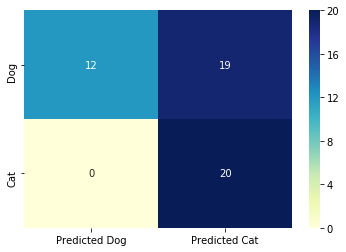

In [30]:
CNN_predicted = CNN_model.predict(X_test_CNN)
print(classification_report(y_test_CNN, CNN_predicted.round()))
CNN_Acc = accuracy_score(y_test_CNN, CNN_predicted.round())
print('Accuracy Score : ', CNN_Acc)
conf_matrix = confusion_matrix(y_test_CNN, CNN_predicted)
label = ['Dog', 'Cat']
label_pred = ['Predicted Dog','Predicted Cat']
sns.heatmap(conf_matrix, annot = True, xticklabels = label_pred, yticklabels = label, fmt = 'd', cmap = 'YlGnBu')

# 3. สรุปและวิจารณ์ผล

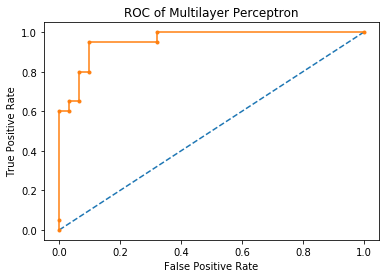

AUC :  0.9580645161290323
Acuracy Score (%) :  88.23529411764706


In [32]:
y_test = lb.fit_transform(y_test)
MLP_probs = MLP_model.predict_proba(X_test)
MLP_positive_probs = MLP_probs[:, 1]
MLP_auc = roc_auc_score(y_test, MLP_positive_probs)
MLP_fpr, MLP_tpr, MLP_thresholds = roc_curve(y_test, MLP_positive_probs)
plt.plot([0, 1], [0, 1], linestyle = '--')
plt.plot(MLP_fpr, MLP_tpr, marker = '.')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC of Multilayer Perceptron')
plt.show()
print('AUC : ',MLP_auc)
print('Acuracy Score (%) : ', MLP_Acc * 100)

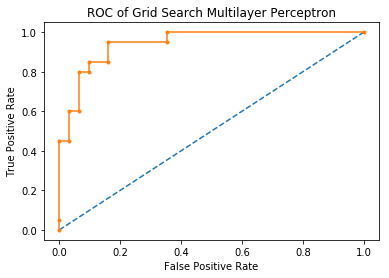

AUC :  0.9435483870967742
Acuracy Score (%) :  84.31372549019608


In [33]:
gridSearch_MLP_probs = gridSearch_MLP.predict_proba(X_test)
gridSearch_MLP_positive_probs = gridSearch_MLP_probs[:, 1]
gridSearch_MLP_auc = roc_auc_score(y_test, gridSearch_MLP_positive_probs)
gridSearch_MLP_fpr, gridSearch_MLP_tpr, gridSearch_MLP_thresholds = roc_curve(y_test, gridSearch_MLP_positive_probs)
plt.plot([0, 1], [0, 1], linestyle = '--')
plt.plot(gridSearch_MLP_fpr, gridSearch_MLP_tpr, marker = '.')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC of Grid Search Multilayer Perceptron')
plt.show()
print('AUC : ',gridSearch_MLP_auc)
print('Acuracy Score (%) : ', gridSearch_MLP_Acc * 100)

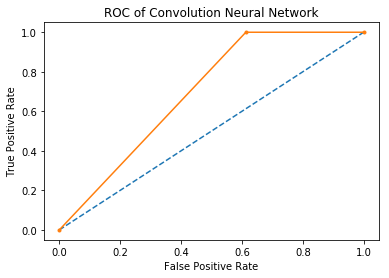

AUC :  0.6935483870967742
Acuracy Score :  62.745098039215684


In [34]:
y_pred_CNN = CNN_model.predict_proba(X_test_CNN).ravel()
CNN_auc = roc_auc_score(y_test_CNN, y_pred_CNN)
CNN_fpr, CNN_tpr, CNN_thresholds = roc_curve(y_test_CNN, y_pred_CNN)
plt.plot([0, 1], [0, 1], linestyle = '--')
plt.plot(CNN_fpr, CNN_tpr, marker = '.')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC of Convolution Neural Network')
plt.show()
print('AUC : ',CNN_auc)
print('Acuracy Score : ', CNN_Acc * 100)

**สรุปผลและวิจารณ์แยกตามหัวข้อ**

    1. Feature Extraction : เนื่องจากข้อมูลที่นำมา train เป็นข้อมูลประเภท Audio File ซึ่งมีความซับซ้อนในเชิงองค์ประกอบของความถี่ที่มีการเปลี่ยนแปลงตลอดเวลา ดังนั้นเพื่ออธิบายถึงคุณลักษณ์ดังกล่าวการใช้กราฟ Spectrogram ซึ่งประกอบด้วยข้อมูลขององค์ประกอบเชิงความถี่ของสัญญาณที่เวลาขณะใดขณะหนึ่งที่แตกต่างกัน จึงมีความเหมาะสม และด้วยการปรับ Spectral Scale ให้อยู่บน Scale ที่เหมาะสมที่สามารถเก็บรายละเอียดของสัญญาณเสียงบนช่วงความถี่ต่ำได้มากขึ้น(ช่วงการรับฟังของมนุษย์) จึงมีการแปลงความถี่ของสัญญาณเสียงไปเป็นความถี่ใน Mel Scale เพื่อคำนวณเป็น Mel-Scaled Spectrogram
    2. Model : ในรายงานฉบับนี่ผู้จัดทำได้เลือกใช้ 3 Model ซึ่งเป็น Nueral Network ทั้งหมด จากค่า Accuracy และ AUC Score ได้บ่งชี้ว่า Multilayer Perceptron ที่ใช้ Default Parameters มีค่า Accuracy และ AUC Score มากที่สุด ดังนั้น ตัวโมเดลมีประสิทธิภาพในการ Classify มากที่สุด(AUC > 0.90)
    ข้อสังเกต : Multilayer Perceptron + GridSreachCV (ทำ 5-fold cross validation) ทุกการ Tuning Hyperparameters จะมีใช้ Default Parameters เสมอ แต่ผลลัพธ์ที่ได้กลับมีค่า Accuracy และ AUC Score ต่ำกว่า Multilayer Perceptron ธรรมดาอย่างน่าประหลาดใจ ในส่วน Convolution Neural Network เนื่องจากผู้จัดทำยังด่อยประสบการณ์ในการกำหนด Layers ใน CNN (ศึกษาและลองทำครั้งนี้เป็นครั้งแรก) และ การประมวลผลของ CNN บนคอมพิวเตอร์ของผู้จัดทำค่อนข้างนานซึ่งเป็นอุปสรรคสำคัญในการเพิ่ม/ลด Layers หรือ กำหนดรายละเอียดต่าง ๆ บน Layers จึงอาจส่งผลให้ประสิทธิภาพไม่ดีเท่าที่ควร ทั้งนี้การทำรายงานฉบับนี้เป็นเพียงก้าวแรกที่สำคัญยิ่งต่อประสบการณ์การทำงานด้าน Data Science ของผู้จัดทำ ผู้จัดทำมีความยิ่งดีเป็นอย่างยิ่งต่อข้อเสนอแนะต่าง ๆ และ จะนำข้อเสนอแนะต่าง ๆ ร่วมทั้งการหาความรู้ใหม่ ๆ มาเพิ่งพูนประสบการณ์การทำงานด้านนี้สืบไป

# Graded  26/30

1. RGB image เป็น 3-d array ไม่ใช่ matrix (2d)
2. ควร split train/test ที่เดียวตอนเริ่มต้น แล้วใช้ทุกการทดลอง
3. training sample น้อยลงผลจะแย่ก็ไม่แปลก
4. CNN น่าจะรันนานกว่านี้ (จนกว่า overfit ที่ training data แล้วทำ early stopping บน validation set เอา)